# **Preparing Dependancies**

In [1]:
!pip install -q diffusers transformers accelerate safetensors pillow

In [2]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import gc
from transformers import CLIPSegProcessor, CLIPSegForImageSegmentation

from diffusers import (
    StableDiffusionPipeline,
    StableDiffusionImg2ImgPipeline,
    EulerAncestralDiscreteScheduler,
    DPMSolverMultistepScheduler,
    DDIMScheduler,
    StableDiffusionInpaintPipeline
)

import warnings
warnings.filterwarnings("ignore")

2026-01-31 11:02:26.697031: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1769857346.875276      55 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1769857346.923630      55 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1769857347.321224      55 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1769857347.321274      55 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1769857347.321277      55 computation_placer.cc:177] computation placer alr

# **Kriteria 1: Melakukan Image Generation dari Teks (Text-to-Image)**

## **Load Base Pipeline Model**

In [3]:
model = "runwayml/stable-diffusion-v1-5"

# Load Pipeline Text-to-Image
pipe = StableDiffusionPipeline.from_pretrained(
    model,
    torch_dtype=torch.float16,
    use_safetensors=True,
    safety_checker=None
)

pipe = pipe.to("cuda")
pipe.enable_attention_slicing()

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


## **Generate Image**

In [4]:
def generate_simple_image(prompt):
  image_base = pipe(prompt).images[0]
  return image_base

  0%|          | 0/50 [00:00<?, ?it/s]

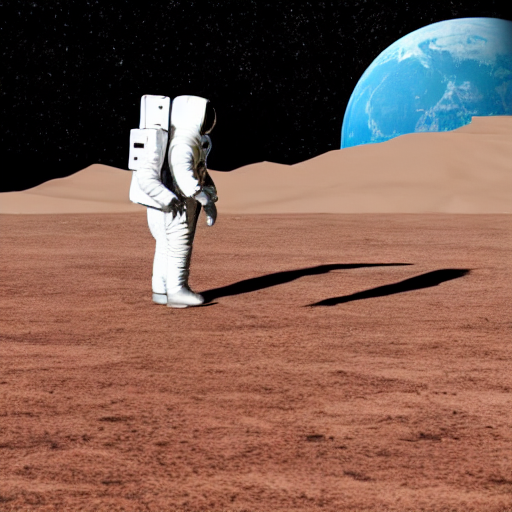

In [5]:
prompt ="Look from very afar, An astronaut on a moon surface red, a blue earth and dark space behind him"

torch.manual_seed(222)
img_simple = generate_simple_image(prompt)
img_simple

## **Generate Image with Hyperparameter Configuration**

In [6]:
def generate_advanced_image(prompt, negative_prompt, guidance_scale, num_inference_steps, seed):
  generator = torch.Generator("cuda").manual_seed(seed)

  images_adv = pipe(
      prompt=prompt,
      negative_prompt=negative_prompt,
      guidance_scale=guidance_scale,
      num_inference_steps=num_inference_steps,
      generator=generator
  ).images[0]

  return images_adv

  0%|          | 0/20 [00:00<?, ?it/s]

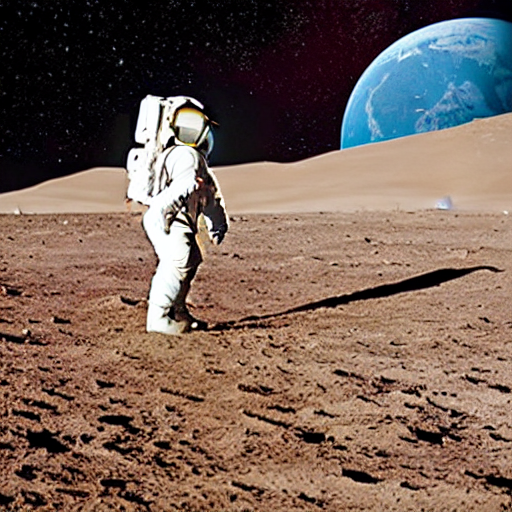

In [7]:
negative_prompt = "photorealistic, realistic, photograph, 3d render, messy, blurry, low quality, bad art, ugly, sketch, grainy, unfinished, chromatic aberration"

img_adv = generate_advanced_image(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=7.5,
    num_inference_steps=20,
    seed = 222
)

img_adv

## **Guidance Scale Comparison**

  0%|          | 0/20 [00:00<?, ?it/s]

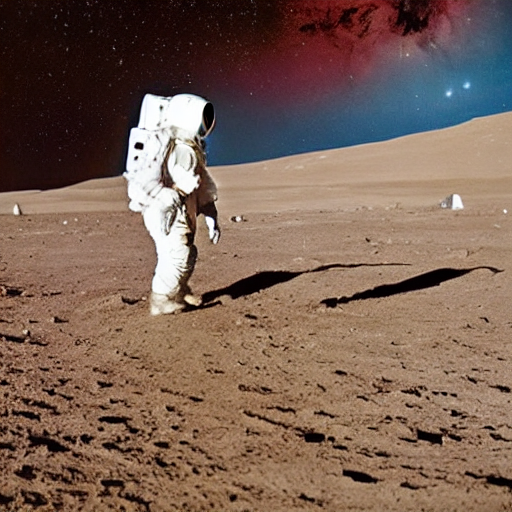

In [8]:
# Low guidance scale
img_low_scale = generate_advanced_image(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=5,
    num_inference_steps=20,
    seed=222
)

img_low_scale

  0%|          | 0/20 [00:00<?, ?it/s]

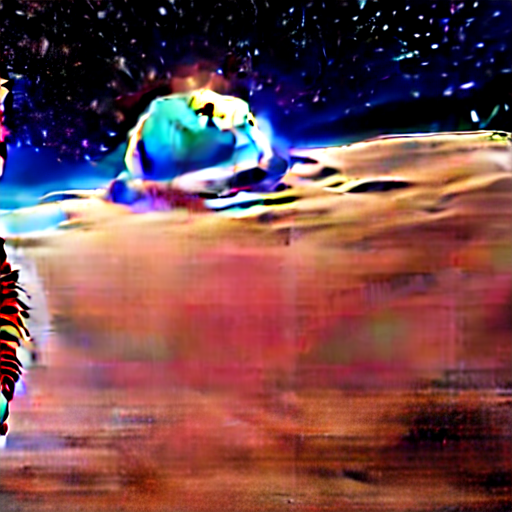

In [9]:
# High guidance scale
img_high_scale = generate_advanced_image(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=50,
    num_inference_steps=20,
    seed=222
)

img_high_scale

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

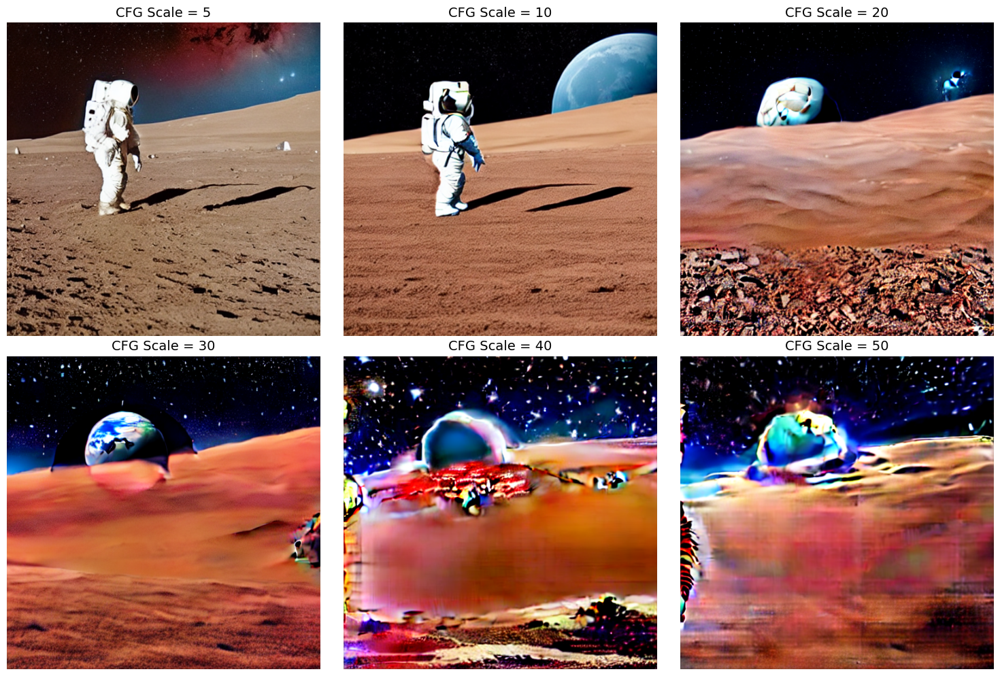

In [10]:
guidance_scales = [5, 10, 20, 30, 40, 50]
num_inference_steps = 20
seed = 222

images = []

for scale in guidance_scales:
    img = generate_advanced_image(
        prompt,
        negative_prompt, 
        scale,
        num_inference_steps,
        seed
    )
    images.append(img)


plt.figure(figsize=(15, 10))
for i, img in enumerate(images):
    plt.subplot(2, 3, i+1)
    plt.imshow(img)
    plt.title(f"CFG Scale = {guidance_scales[i]}", fontsize=14)
    plt.axis("off")
plt.tight_layout()
plt.show()

### **Guidance Scale Explanation:**

*   **Gambar dengan "Scale" Rendah:**   
*"Pada skala rendah (5 dan 10), gambar terlihat paling natural, pencahayaannya bagus dan astronout masih terlihat proporsional. Secara kesesuaian prompt, di skala 5 AI terlihat lebih 'bebas' sehingga gambar bumi masih belum terlihat (hanya cahaya biru merah). Selanjutnya di skala 10, kepatuhan terhadap prompt meningkat, background terlihat sangat stabil dimana bumi menjadi bulat utuh berwarna biru sesuai deskripsi. Terlihat kontras mulai naik sedikit, tanah menjadi lebih merah, dan bayangan terlihat lebih tajam."*

*   **Gambar dengan "Scale" Tinggi:**   
*"Pada skala tinggi (40 dan 50), kedekatan dengan prompt dipaksakan terlalu ekstrim sehingga gambar menjadi oversaturated (rusak). Astronaut menghilang dan bumi terlihat meleleh (mulai dari skala 40) karena AI mengorbankan koherensi visual demi ketegasan pixel. Langit yang sebelumnya hitam menjadi terlihat banyak bintang/noise karena saturasi yang semakin tinggi akibat 'paksaan' instruksi tersebut."*

## **Inference Steps Comparison**

  0%|          | 0/5 [00:00<?, ?it/s]

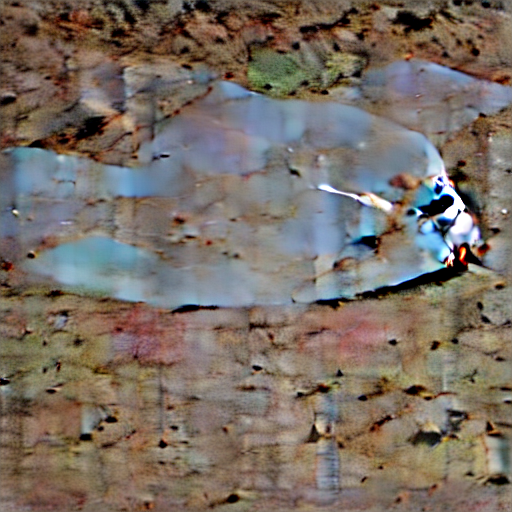

In [11]:
# Low inference step
img_low_steps = generate_advanced_image(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=10,
    num_inference_steps=5,
    seed=222
)

img_low_steps

  0%|          | 0/100 [00:00<?, ?it/s]

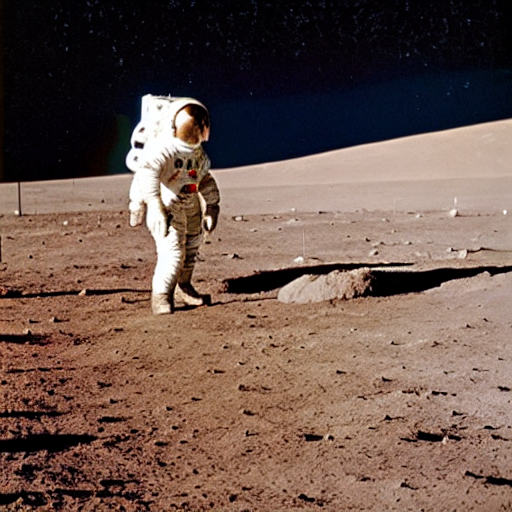

In [12]:
# High inference step
img_high_steps = generate_advanced_image(
    prompt=prompt,
    negative_prompt=negative_prompt,
    guidance_scale=10,
    num_inference_steps=100,
    seed=222
)

img_high_steps

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

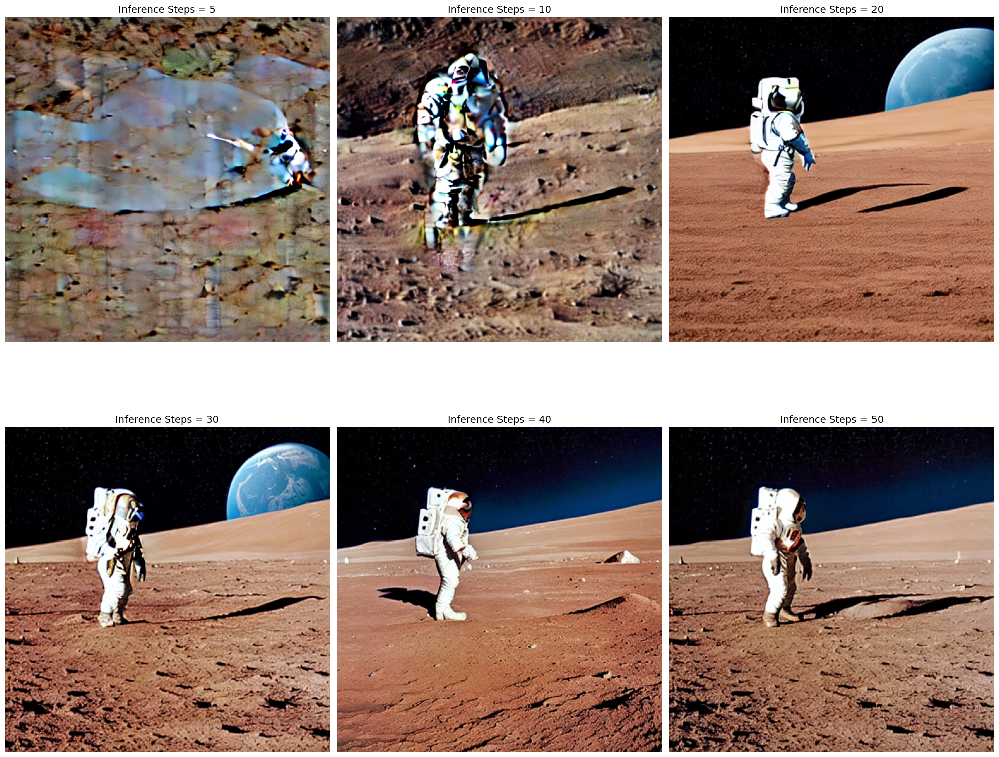

In [13]:
guidance_scales = 10
num_inference_steps = [5, 10, 20, 30, 40, 50]
seed = 222

images = []

for step in num_inference_steps:
    img = generate_advanced_image(
        prompt,
        negative_prompt, 
        guidance_scales,
        step,
        seed
    )
    images.append(img)


plt.figure(figsize=(20, 18))
for i, img in enumerate(images):
    plt.subplot(2, 3, i+1)
    plt.imshow(img)
    plt.title(f"Inference Steps = {num_inference_steps[i]}", fontsize=14)
    plt.axis("off")
plt.tight_layout()
plt.show()

### **Inference Step Explanation:**

*   **Gambar dengan "Step" Rendah:**  
*"Gambar yang dihasilkan pada inference step rendah (5 steps), gambarnya masih tidak terlihat bentuknya. Bentuk objek belum terdefinisi jelas,, hanya terlihat tanah dan cikal bakal seperti untuk astronaut atau bumi yang abstrak dan gepeng. Gambar masih tertutup noise parah dan sangat buram. Saat masuk ke steps 10, gambar mulai terbentuk dan siluet astronaut mulai terlihat, namun visualnya masih penuh artefak, terdistorsi, dan pencahayaannya belum matang sehingga belum layak untuk digunakan."*
*   **Gambar dengan "Step" Tinggi:**  
*"Pada inference step tinggi (40 dan 50), gambar telah mencapai stabilitas visual yang maksimal. Hasilnya sangat halus, tajam, dan detail (bebas dari noise). Namun, terjadi perubahan komposisi yang unik di mana elemen Bumi justru menghilang dibandingkan step 30 (sweet spot). Antara step 40 dan 50 tidak terlihat perbedaan signifikan (diminishing returns), menandakan bahwa model sudah konvergen dan penambahan step hanya mematangkan tekstur tanah tanpa mengubah bentuk utama lagi."*


- Sweet spot = step 30 (Karena gambar sudah tajam, tapi elemen Bumi masih terlihat lengkap dan detail)

## **Batch Inference from One Prompt**

  0%|          | 0/30 [00:00<?, ?it/s]

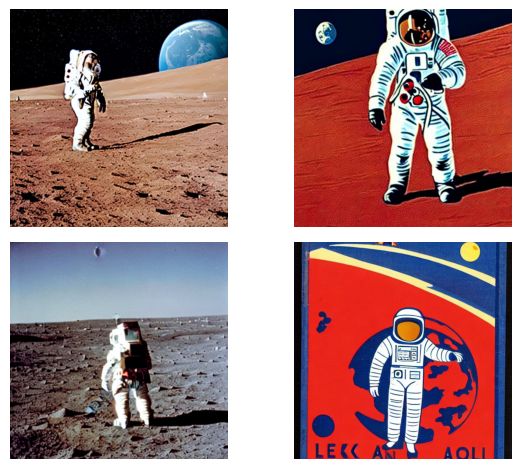

In [14]:
generator = torch.Generator("cuda").manual_seed(222)

images_batch = pipe(
    prompt=[prompt] * 4,
    negative_prompt=[negative_prompt] * 4,
    num_inference_steps=30,
    guidance_scale=10,
    generator=generator
).images

for i, img in enumerate(images_batch):
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)
    plt.axis("off")
plt.tight_layout()
plt.show()

## **Load Scheduler**

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

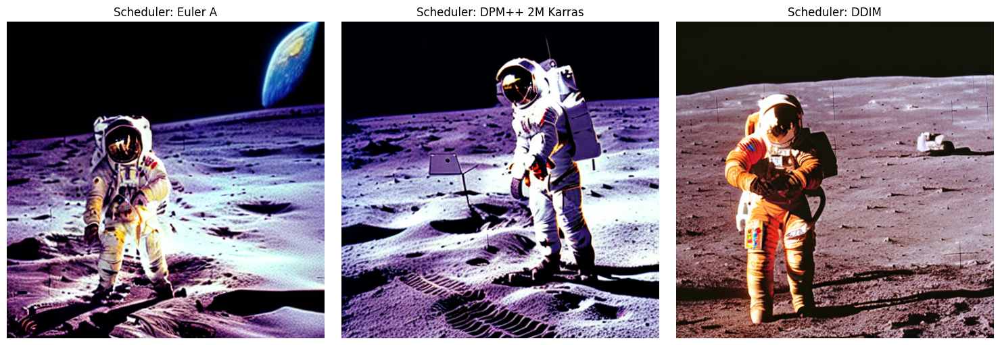

In [15]:
scheduler_configs = [
    (EulerAncestralDiscreteScheduler, "Euler A"),
    (DPMSolverMultistepScheduler, "DPM++ 2M Karras"),
    (DDIMScheduler, "DDIM")
]

images = []
generator = torch.Generator("cuda").manual_seed(seed)

for scheduler_class, name in scheduler_configs:
    pipe.scheduler = scheduler_class.from_config(pipe.scheduler.config)

    img = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt, 
        guidance_scale=10,
        num_inference_steps=30,
        generator=generator
    ).images[0]
    images.append((name, img))

plt.figure(figsize=(15, 5))
for i, (name, img) in enumerate(images):
    plt.subplot(1, 3, i + 1)
    plt.imshow(img)
    plt.title(f"Scheduler: {name}")
    plt.axis("off")
plt.tight_layout()
plt.show()

### **Scheduler Comparation:**

*   **Gambar dengan "Euler A Scheduler":**  
*"Gambar yang dihasilkan cenderung artistik dengan pencahayaan yang dramatis dan soft. Terlihat komposisi warna yang kontras dengan latar belakang Bumi yang sangat menonjol dan jelas. KArena Euler A (Ancestral) menambahkan sedikit variasi noise di setiap langkahnya, sehingga hasilnya seringkali terlihat lebih kreatif dan dreamy."*
*   **Gambar dengan "DPM++ Scheduler":**  
*"Hasil dari DPM++ 2M Karras terlihat paling tajam, bersih, dan modern (mirip render 3D high-quality). Detail pada tekstur permukaan bulan (seperti jejak di tanah) dan baju astronaut terlihat sangat presisi dan tegas. Tone warnanya cenderung lebih dingin (cool tone) dibandingkan yang lain, menunjukkan karakteristik scheduler yang sangat efisien dalam menangkap detail struktur."*
*   **Gambar dengan "DDIM Scheduler":**  
*"Gambar ini memberikan nuansa yang lebih raw dan realistik, menyerupai foto dokumentasi analog atau vintage. Pencahayaannya lebih hangat (kemerahan/sepia) dengan tekstur tanah yang terlihat lebih kasar dan berbatu. DDIM cenderung menghasilkan gambar yang deterministik dan setia pada data pelatihan, sehingga outputnya terasa lebih 'membumi' dan kurang bergaya fantasi."*

# **Kriteria 2: Menyempurnakan Gambar Melalui Image-to-Image**

## **Base + Refiner Image Generation**

In [16]:
refiner = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    text_encoder=pipe.text_encoder,
    vae=pipe.vae,
    unet=pipe.unet,
    tokenizer=pipe.tokenizer,
    safety_checker=None,
    torch_dtype=torch.float16
).to("cuda")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.StableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

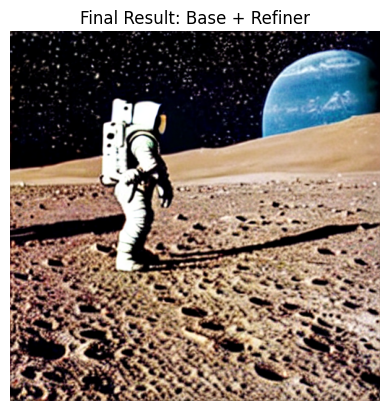

In [17]:
new_prompt = prompt

image_base = pipe(
    prompt=new_prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=30,       
    denoising_end=0.8,       
    output_type="latent",
    guidance_scale=10,
    generator=torch.Generator("cuda").manual_seed(222) 
).images[0]


image_refined = refiner(
    prompt=new_prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=30,
    denoising_start=0.8,          
    image=image_base,          
    guidance_scale=10,
    generator=torch.Generator("cuda").manual_seed(222)
).images[0]

plt.imshow(image_refined)
plt.title("Final Result: Base + Refiner")
plt.axis("off")
plt.show()

final_image = image_refined

## **Inpainting**

### **Load Model Inpainting**

In [18]:
model = "runwayml/stable-diffusion-inpainting"

pipe_inpaint = StableDiffusionInpaintPipeline.from_pretrained(
    model,
    torch_dtype=torch.float16,
    safety_checker=None
)

pipe_inpaint = pipe_inpaint.to("cuda")
pipe_inpaint.enable_attention_slicing()

model_index.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/748 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

text_encoder/pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/552 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
You have disabled the safety checker for <class 'diffusers.pipelin

### **Manual Masking**

In [19]:
width, height = final_image.size
print(width, height)

512 512


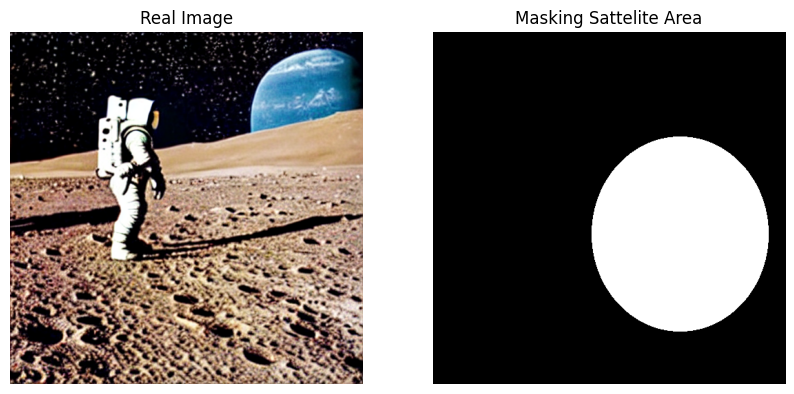

In [20]:
mask = Image.new("L", final_image.size, 0)
draw = ImageDraw.Draw(mask)

# Mask coordinat
left = width * 0.45
top = height * 0.30
right = width * 0.95
bottom = height * 0.85

draw.ellipse((left, top, right, bottom), fill=255)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(final_image)
plt.title("Real Image")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(mask, cmap="gray")
plt.title("Masking Sattelite Area")
plt.axis("off")
plt.show()

### **Generate**

In [21]:
def inpaint_engine(image, mask, prompt, negative_prompt, num_steps=30, guidance_scale=10):
    global pipe_inpaint
    
    generator = torch.Generator("cuda").manual_seed(9)
    
    output = pipe_inpaint(
        prompt=prompt,
        negative_prompt=negative_prompt,
        image=image,
        mask_image=mask,
        num_inference_steps=num_steps,
        guidance_scale=guidance_scale,
        generator=generator
    ).images[0]
    
    return output

  0%|          | 0/60 [00:00<?, ?it/s]

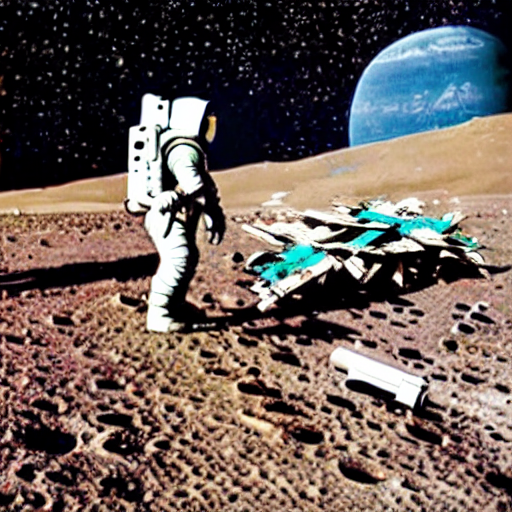

In [22]:
prompt_inpainting = "a broken teal satelitte wreckage crashed, cinematic lighting, realistic"

negative_prompt_inpainting = "astronaut, person, body, sand dune, empty space, bad quality, blurry"


image_inpainting = inpaint_engine(
    prompt=prompt_inpainting,
    negative_prompt=negative_prompt_inpainting,
    image=final_image,    
    mask=mask,            
    guidance_scale=25,    
    num_steps=60          
)

image_inpainting

## **Inpainting Menggunakan Automasking**

### **load Model Segmentation Untuk Masking**

In [23]:
processor = CLIPSegProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
model_seg = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/380 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/974 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/603M [00:00<?, ?B/s]

### **Masking with Segmentation Model**

In [24]:
def get_mask(image, prompt, threshold=0.4):
    inputs = processor(
        text=[prompt],
        images=[image],
        padding="max_length",
        return_tensors="pt"
    )

    with torch.no_grad():
        outputs = model_seg(**inputs)

    preds = outputs.logits.unsqueeze(1)

    preds = torch.nn.functional.interpolate(
        preds,
        size=(image.height, image.width),
        mode='bilinear',
        align_corners=False
    )

    mask_tensor = torch.sigmoid(preds) > threshold

    mask_np = mask_tensor[0, 0].cpu().numpy() 
    mask_pil = Image.fromarray((mask_np * 255).astype('uint8'), 'L')

    return mask_pil

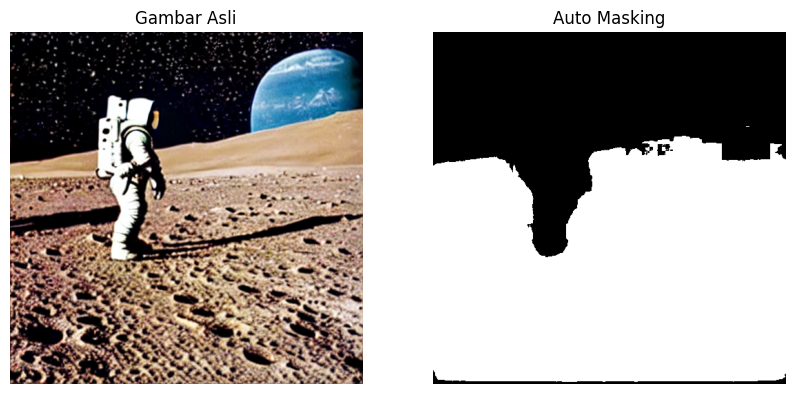

In [25]:
mask_prompt = "red sandy ground, in front of astronout" 

auto_mask = get_mask(final_image, mask_prompt, threshold=0.4)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(final_image)
plt.title("Gambar Asli")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(auto_mask, cmap="gray")
plt.title(f"Auto Masking")
plt.axis("off")
plt.show()

### **Generate**

  0%|          | 0/75 [00:00<?, ?it/s]

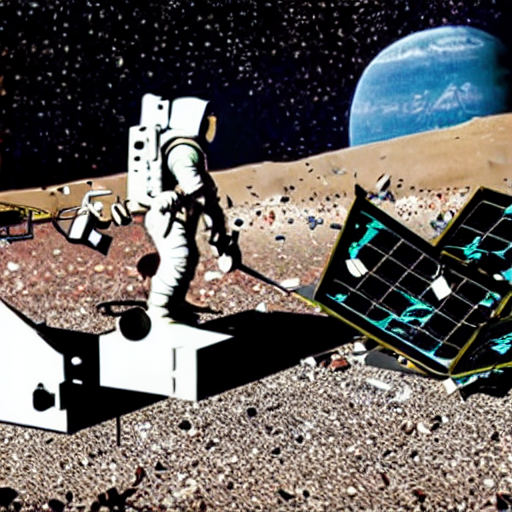

In [26]:
prompt_inpainting = "a broken teal lunar finder satelitte wreckage crashed, broken solar panel, cinematic lighting, realistic"

negative_prompt_inpainting = "astronaut, person, body, sand dune, empty space, bad quality, blurry"

generator = torch.Generator("cuda").manual_seed(9)

image_auto_mask = inpaint_engine(
    prompt=prompt_inpainting,
    negative_prompt=negative_prompt_inpainting,
    image=final_image,  
    mask=auto_mask,               
    num_steps=75,                 
    guidance_scale=20           
)

image_auto_mask

## **Outpainting**

### **Prepare the Canvas**

In [27]:
def prepare_outpainting(image, direction='right', expand_pixels=256):

    old_width, old_height = image.size
    
    if direction == 'left':
        new_width = old_width + expand_pixels
        new_height = old_height
        paste_x, paste_y = expand_pixels, 0 
        
    elif direction == 'right':
        new_width = old_width + expand_pixels
        new_height = old_height
        paste_x, paste_y = 0, 0 
        
    elif direction == 'up':
        new_width = old_width
        new_height = old_height + expand_pixels
        paste_x, paste_y = 0, expand_pixels 
        
    elif direction == 'down':
        new_width = old_width
        new_height = old_height + expand_pixels
        paste_x, paste_y = 0, 0 


    outpaint_image = Image.new("RGB", (new_width, new_height), (0, 0, 0))
    

    outpaint_mask = Image.new("L", (new_width, new_height), 255)

    outpaint_image.paste(image, (paste_x, paste_y))
    
    original_area_mask = Image.new("L", (old_width, old_height), 0) 
    outpaint_mask.paste(original_area_mask, (paste_x, paste_y))
    
    return outpaint_image, outpaint_mask

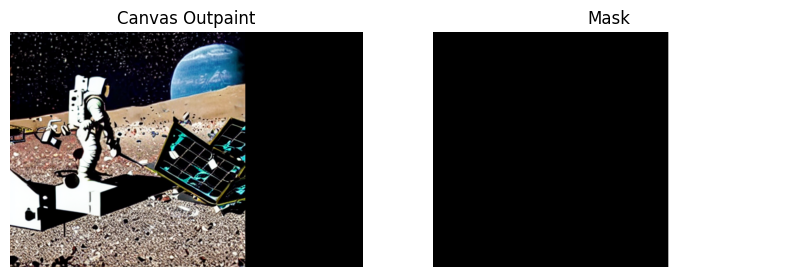

In [28]:
image_canvas, mask_canvas = prepare_outpainting(image_auto_mask, direction='right', expand_pixels=256)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image_canvas)
plt.title("Canvas Outpaint")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(mask_canvas, cmap='gray')
plt.title("Mask") # putih adalah area generate
plt.axis("off")
plt.show()

### **Generate**

  0%|          | 0/50 [00:00<?, ?it/s]

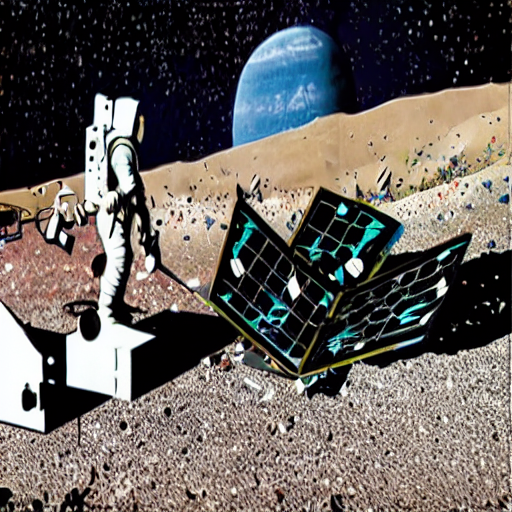

In [29]:
prompt_outpaint = "right side of huge blue earth planet, curved horizon line, dark space background, stars, red sandy ground, seamless blend, highly detailed, 8k"

negative_prompt_out = "rings, saturn, jupiter, double planets, two planets, bad quality, blurry, watermark, text, frame, border"

image_outpainting = inpaint_engine(
    prompt=prompt_outpaint,
    negative_prompt=negative_prompt_out,
    image=image_canvas,      
    mask=mask_canvas,       
    num_steps=50,        
    guidance_scale=10       
)

image_outpainting

## **Outpainting Zoom Out**

### **Prepare Canvas for Zoom Out**

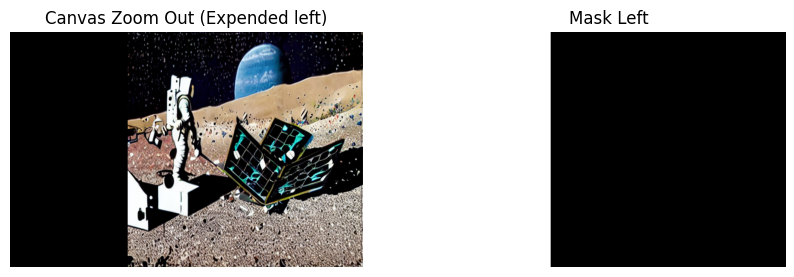

In [30]:
# Canvas zoom out left
canvas_left, mask_left = prepare_outpainting(image_outpainting, direction='left', expand_pixels=256)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(canvas_left)
plt.title("Canvas Zoom Out (Expended left)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(mask_left, cmap='gray')
plt.title("Mask Left")
plt.axis("off")

plt.show()

### **Generate**

  0%|          | 0/50 [00:00<?, ?it/s]

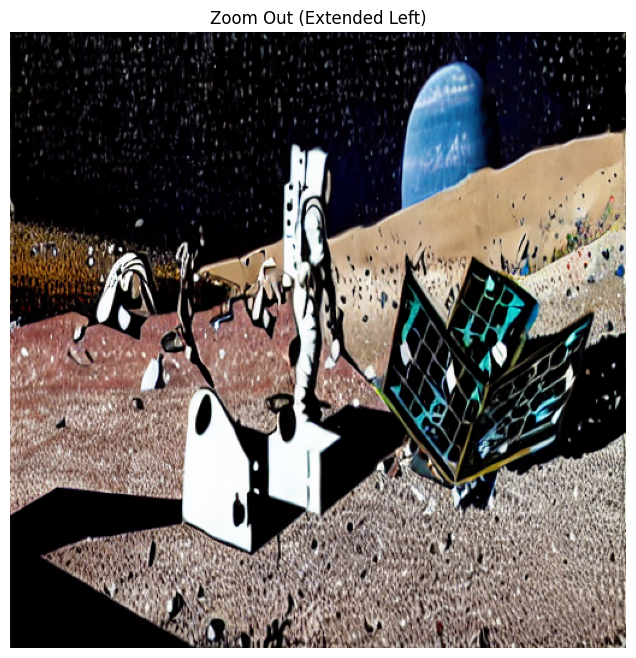

In [31]:
# generate zoom out left
prompt_zoom="continuation of red sandy ground surface, rocks, dust, empty space, realistic texture, cinematic lighting"
negative_prompt_zoom="sky, stars, planet, building, astronaut, person, frame, water, text"

image_zoom_left = inpaint_engine(
    prompt=prompt_zoom,
    negative_prompt=negative_prompt_zoom,
    image=canvas_left,     
    mask=mask_left,          
    num_steps=50,       
    guidance_scale=10
)

plt.figure(figsize=(10, 8)) 
plt.imshow(image_zoom_left)
plt.title("Zoom Out (Extended Left)")
plt.axis("off")
plt.show()

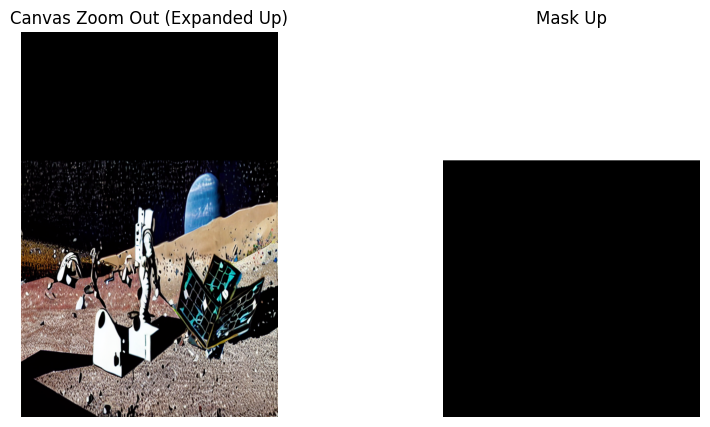

In [32]:
# Canvas zoom out up
canvas_up, mask_up = prepare_outpainting(image_zoom_left, direction='up', expand_pixels=256)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(canvas_up)
plt.title("Canvas Zoom Out (Expanded Up)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(mask_up, cmap='gray')
plt.title("Mask Up")
plt.axis("off")

plt.show()

  0%|          | 0/50 [00:00<?, ?it/s]

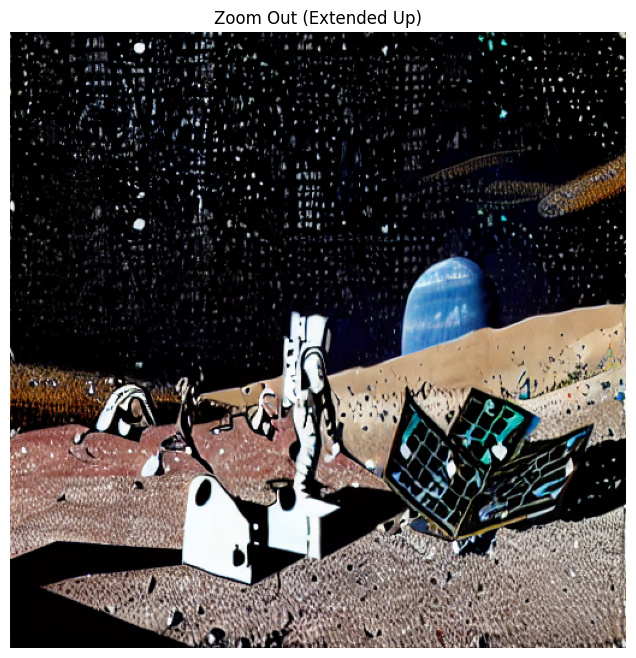

In [33]:
# generate zoom out up
prompt_up = "dark outer space background, stars, nebula, distant galaxies, cosmic void, cinematic, 8k, realistic"

neg_prompt_up = "ground, sand, rocks, mountains, sun, bright light, horizon, building, tree"


image_zoom_up = inpaint_engine(
    prompt=prompt_up,
    negative_prompt=neg_prompt_up,
    image=canvas_up,       
    mask=mask_up,       
    num_steps=50,
    guidance_scale=10
)

plt.figure(figsize=(10, 8)) 
plt.imshow(image_zoom_up)
plt.title("Zoom Out (Extended Up)")
plt.axis("off")
plt.show()

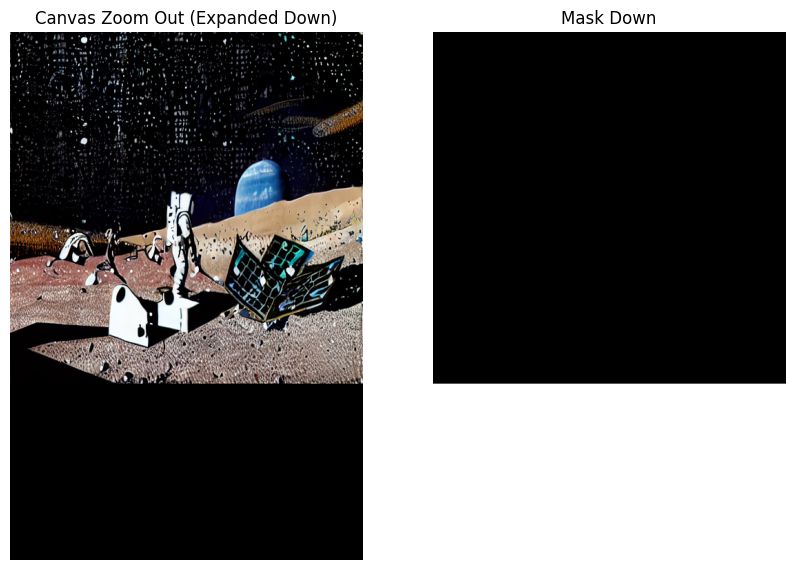

In [34]:
# Canvas zoom out down
canvas_down, mask_down = prepare_outpainting(image_zoom_up, direction='down', expand_pixels=256)

plt.figure(figsize=(10, 8))

plt.subplot(1, 2, 1)
plt.imshow(canvas_down)
plt.title("Canvas Zoom Out (Expanded Down)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(mask_down, cmap='gray')
plt.title("Mask Down")
plt.axis("off")

plt.show()

  0%|          | 0/50 [00:00<?, ?it/s]

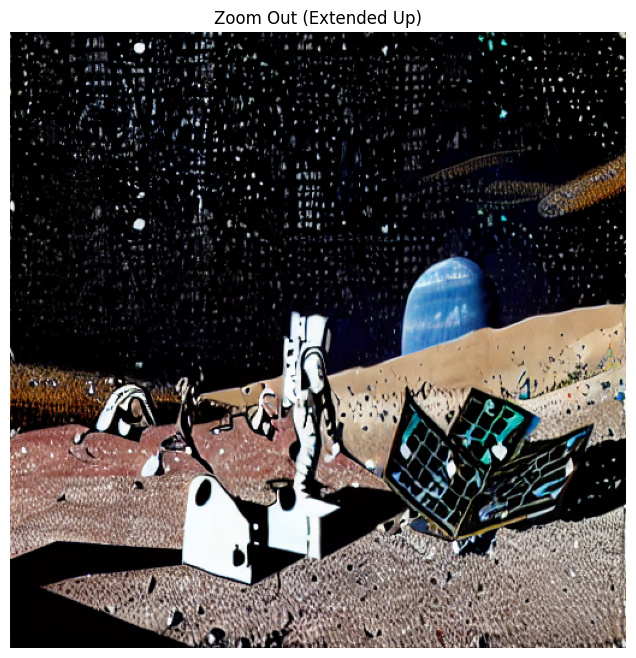

In [35]:
# generate zoom out down
prompt_down = "continuation of red sandy ground surface, moon rocks, dust, gravel, crater, realistic texture, cinematic lighting, 8k, seamless"

neg_prompt_down = "sky, stars, planet, building, astronaut, person, frame, border, water, text"

image_zoom_down = inpaint_engine(
    prompt=prompt_down,
    negative_prompt=neg_prompt_down,
    image=canvas_down,      
    mask=mask_down,        
    num_steps=50,
    guidance_scale=10
)

plt.figure(figsize=(10, 8)) 
plt.imshow(image_zoom_up)
plt.title("Zoom Out (Extended Up)")
plt.axis("off")
plt.show()